In [1]:
from scipy.io import loadmat
import numpy as np 
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
from collections import Counter
from findClosestCentroids import *
from computeCentroids import *
from runkMeans import *
from kMeansInitCentroids import *
from plotDataPoints import *

In [2]:
data = loadmat('clusters.mat')
X = data['X']

# Find closest centroids

In [3]:
# Select an initial set of centroids
K = 3
initial_centroids = np.array([[3, 3], [6, 2], [8, 5]])
# Find the closest centroids for the examples using the initial_centroids
idx = findClosestCentroids(X, initial_centroids)
print('Closest centroids for the first 3 examples: {} {} {}' .format(*idx[:3]))
print('(the closest centroids should be 1, 3, 2 respectively)')

Closest centroids for the first 3 examples: 1 3 2
(the closest centroids should be 1, 3, 2 respectively)


# Compute means

In [4]:
# Compute means based on the closest centroids found in the previous part.
centroids = computeCentroids(X, idx, K)
print('Centroids computed after initial finding of closest centroids: \n{}\n{}\n{}'.format(*centroids))
print('(the centroids should be\n[ 2.428301 3.157924 ]\n[ 5.813503 2.633656 ]\n[ 7.119387 3.616684 ])')

Centroids computed after initial finding of closest centroids: 
[2.42830111 3.15792418]
[5.81350331 2.63365645]
[7.11938687 3.6166844 ]
(the centroids should be
[ 2.428301 3.157924 ]
[ 5.813503 2.633656 ]
[ 7.119387 3.616684 ])


# K-means clustering

## With specific initialization

K-Means iteration 1/10
K-Means iteration 2/10
K-Means iteration 3/10
K-Means iteration 4/10
K-Means iteration 5/10
K-Means iteration 6/10
K-Means iteration 7/10
K-Means iteration 8/10
K-Means iteration 9/10
K-Means iteration 10/10


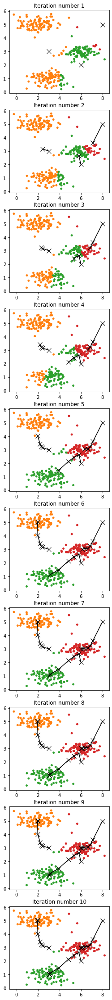

In [5]:
# Settings for running K-Means
max_iters = 10
# Run K-Means algorithm
_, _ = runkMeans(X, initial_centroids, max_iters, plot_progress=True)

## With random initialization

K-Means iteration 1/10
K-Means iteration 2/10
K-Means iteration 3/10
K-Means iteration 4/10
K-Means iteration 5/10
K-Means iteration 6/10
K-Means iteration 7/10
K-Means iteration 8/10
K-Means iteration 9/10
K-Means iteration 10/10


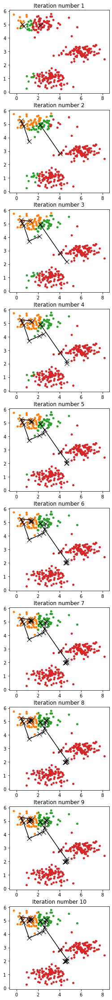

In [6]:
# Settings for running K-Means
max_iters = 10
rand_initial_centroids = kMeansInitCentroids(X, K)
# Run K-Means algorithm
_, _ = runkMeans(X, rand_initial_centroids, max_iters, plot_progress=True)

# Image compression with K-means 

## K-means clustering on pixels

In [7]:
data_bird = loadmat('bird_small.mat')
# Scale values from uint8 [0..255] to float64 [0..1]
img = data_bird['A'] / 255
# Reshape the image into an Nx3 matrix where N = number of pixels
# Each row will contain the Red, Green and Blue pixel values
# This gives us our dataset matrix X that we will use K-Means on
h, w, c = img.shape
X_bird = img.reshape(h * w, c)

In [8]:
# Run K-Means algorithm on this data
K_bird = 16
max_iters = 10
# When using K-Means, it is important the initialize the centroids randomly
rand_initial_centroids = kMeansInitCentroids(X_bird, K_bird)
# Run K-Means
centroids_bird, _ = runkMeans(X_bird, rand_initial_centroids, max_iters)

K-Means iteration 1/10
K-Means iteration 2/10
K-Means iteration 3/10
K-Means iteration 4/10
K-Means iteration 5/10
K-Means iteration 6/10
K-Means iteration 7/10
K-Means iteration 8/10
K-Means iteration 9/10
K-Means iteration 10/10


## Image compression

In [9]:
# Find closest cluster members
idx_bird = findClosestCentroids(X_bird, centroids_bird)
# We can now recover the image from the indices (idx) by mapping each pixel
# (specified by its index in idx) to the centroid value
img_recovered = centroids_bird[idx_bird - 1, :].reshape(h, w, c)

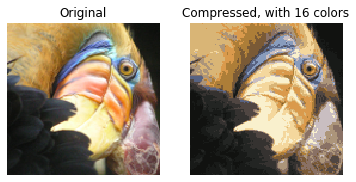

In [10]:
_, ax = plt.subplots(1, 2)
ax[0].imshow(img)
ax[0].set_title('Original')
ax[1].imshow(img_recovered)
ax[1].set_title('Compressed, with %d colors' %K_bird)
for axis in ax: axis.axis('off')

# Advanced optimization algorithms

## K-means

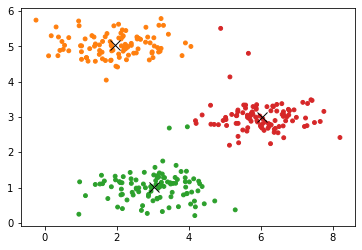

In [11]:
kmeans = KMeans(n_clusters=3, init='random', n_init=5, max_iter=10).fit(X)
plotDataPoints(X, kmeans.labels_ + 1)
plt.plot(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], 'kx', markersize=10, linewidth=3)

## Elbow method

In [12]:
def curvature(y, *x, grad_edge_order=1):
    # Normalize to minimize scale effects in curvature calculation
    y = y / np.max(y)
    # curvature = y" / (1 + y' ^ 2) ^ (3 / 2) 
    y1 = np.gradient(y, *x, edge_order=grad_edge_order)
    y2 = np.gradient(y1, *x, edge_order=grad_edge_order)
    return (y2 / (1 + y1 ** 2) ** 1.5)

def plotElbow(k, v, v_label=None, k_elbow=None):
    plt.plot(k, v, 'x-')
    plt.suptitle('Elbow method')
    if k_elbow is not None:
        plt.plot(k[k_elbow], v[k_elbow], 'ro', markersize=12, markeredgewidth=2, markerfacecolor='None')
        plt.title('Choice of k = %d' %(k_elbow + 1))
    plt.xlabel('Number of clusters k')
    plt.ylabel(v_label)

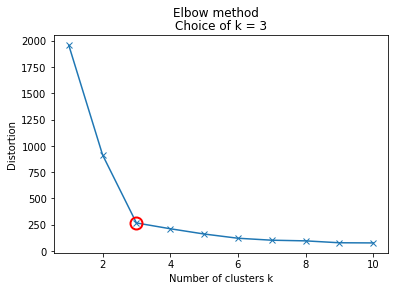

In [13]:
# Compute k-means for multiple values of k
wss = []
K_rng = range(1, 11)
for k in K_rng:
    kmeans = KMeans(n_clusters=k, init='random', n_init=5, max_iter=10).fit(X)
    wss.append(kmeans.inertia_)
# Find point with max curvature
wss = np.array(wss) 
curv = curvature(wss, grad_edge_order=2)
kIdx = np.argmax(curv)
# Plot
plotElbow(K_rng, wss, v_label='Distortion', k_elbow=kIdx)

## Silhouette method

In [14]:
def plotSilhouetteAnalysis(X, labels):
    # Retrieve the number of clusters 
    k = len(Counter(labels))
    # Compute silhouettes
    silhouettes = silhouette_samples(X, labels)
    # New subplot
    _, ax = plt.subplots(1, 2)
    # Remove y axis labels
    ax[0].set_yticks([])
    ax[0].set_yticklabels([])
    # Position variables for plotting silhouette -clusters on y axis
    pad = 10
    y_lbound = 0
    ymargin = ax[0].margins()[1]
    ymax = (silhouettes.shape[0] + (k - 1) * pad) * (1 + 2 * ymargin)
    # Define colors
    colors = [{j: 'C' + str(j) for j in range(min(labels), max(labels) + 1)}[i] for i in labels]
    # For each cluster
    for l in range(k):
        # Aggregate the silhouette scores for samples belonging to cluster l, and sort them
        silhouettes_l = silhouettes[labels == l]
        silhouettes_l.sort()
        # Plot silhouettes
        y_ubound = y_lbound + silhouettes_l.shape[0] 
        ax[0].fill_betweenx(range(y_lbound, y_ubound), 0, silhouettes_l, color=sorted(Counter(colors).keys())[l])
        # Plot average silhouettes over each cluster
        ax[0].axvline(np.mean(silhouettes_l), y_lbound / ymax + ymargin, (y_ubound - 1) / ymax + ymargin, c='k', linestyle='-')
        y_lbound = y_ubound + pad
    # x axis scale from 0 to 1
    ax[0].set_xticks(np.linspace(0, 1, 6))
    # Plot average silhouette
    ax[0].axvline(silhouette_score(X, labels), c='r', linestyle='--')
    # Title and labels for silhouette plot
    ax[0].set_title('Silhouette')
    ax[0].set_xlabel('Silhouette coefficients')
    ax[0].set_ylabel('Clusters')
    # Plot clustered data on side subplot
    ax[1].scatter(X[:, 0], X[:, 1], s=15, c=colors)
    ax[1].set_title('Clustered data')
    # Suptitle
    plt.suptitle('Silhouette analysis with k = %d' %(k))

def plotSilhouetteCurve(k, s, k_silhouette=None):
    plt.subplots(1, 1)
    plt.plot(k, s, 'x-')
    if k_silhouette is not None:
        plt.plot(k[k_silhouette], s[k_silhouette], 'ro', markersize=12, markeredgewidth=2, markerfacecolor='None')
        plt.title('Choice of k = %d' %(k[k_silhouette]))
    plt.suptitle('Silhouette method')
    plt.xlabel('Number of clusters k')
    plt.ylabel('Average Silhouette Coefficient')

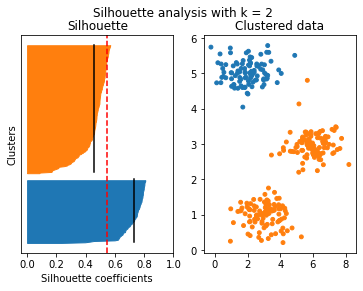

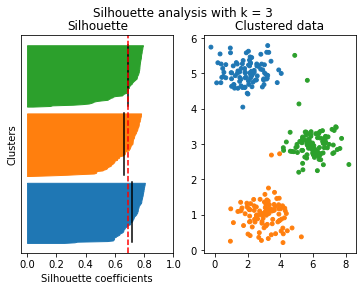

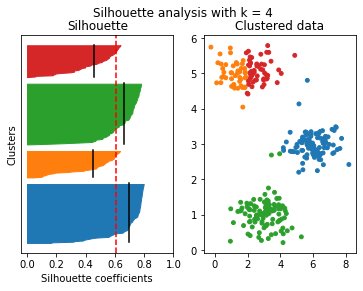

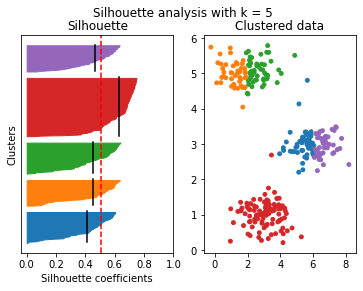

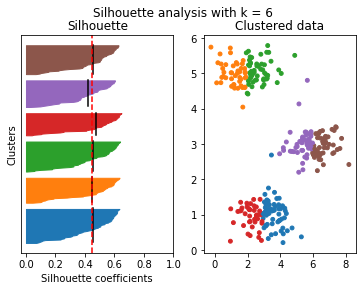

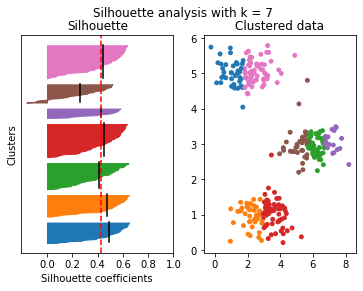

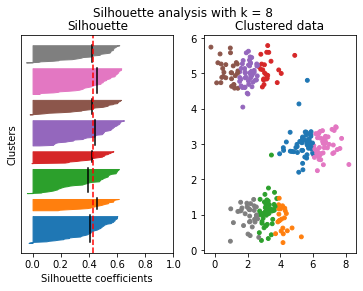

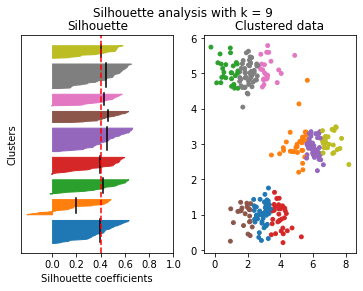

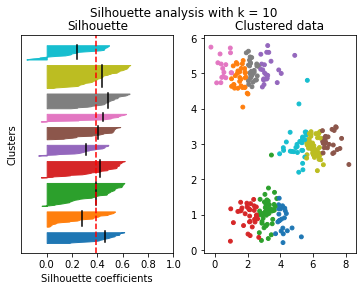

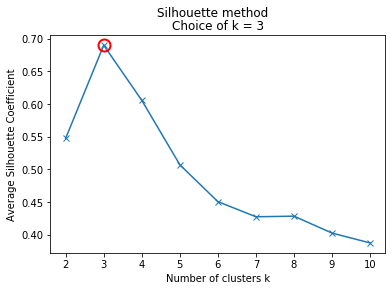

In [15]:
silhouette = []
K_rng = range(2, 11)
for k in K_rng:
    kmeans = KMeans(n_clusters=k, init='random', n_init=5, max_iter=10).fit(X)
    labels = kmeans.labels_
    silhouette.append(silhouette_score(X, labels))
    # Plot silhouettes analysis
    plotSilhouetteAnalysis(X, labels)
# Plot silhouette curve with choice of k
kIdx = np.argmax(silhouette)
plotSilhouetteCurve(K_rng, silhouette, k_silhouette=kIdx)

## Image compression

In [16]:
def plotImgColors3D(ax, X, colors):
    ax.scatter(X[:, 0], X[:, 1], X[:, 2], s=1, c=colors)
    ax.set_xlabel('Red')
    ax.set_ylabel('Green')
    ax.set_zlabel('Blue', rotation=90)
    ax.invert_xaxis()

def plotImgCompColorAnalysis(img, img_comp):
    fig = plt.figure(figsize=(8, 4), constrained_layout=True)
    ax1 = fig.add_subplot(121, projection='3d')
    X = img.reshape(img.shape[0] * img.shape[1], img.shape[2])
    X_comp = img_comp.reshape(img_comp.shape[0] * img_comp.shape[1], img_comp.shape[2])
    plotImgColors3D(ax1, X, X_comp)
    ax2 = fig.add_subplot(122)
    ax2.imshow(img_comp)
    ax2.axis('off')
    return ax1, ax2

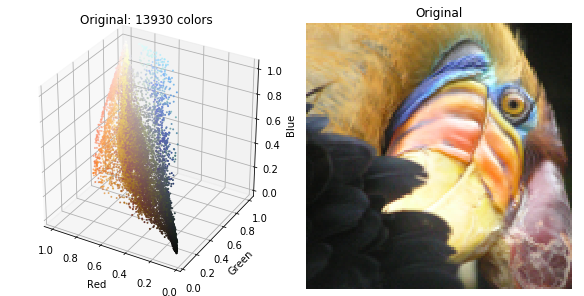

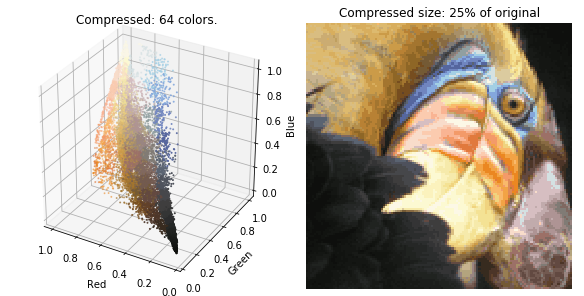

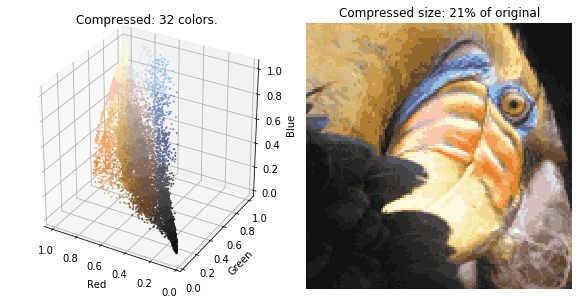

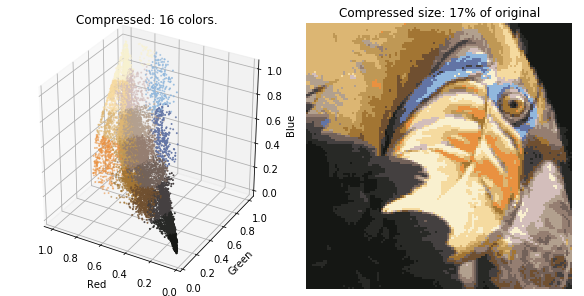

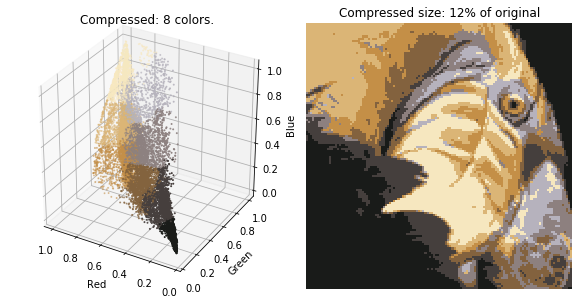

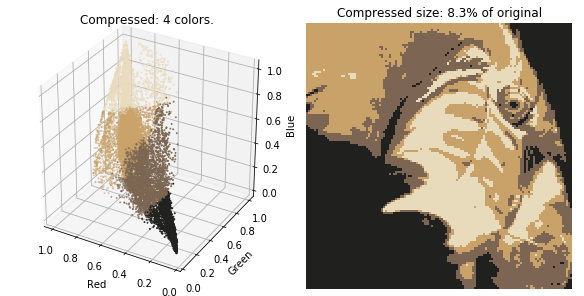

In [17]:
n_clusters = [64, 32, 16, 8, 4]
silhouette = []
ax1, ax2 = plotImgCompColorAnalysis(img, img)
ax1.set_title('Original: %d colors' %(len(np.unique(X_bird, axis=0))))
ax2.set_title('Original')
for k in n_clusters:
    kmeans = KMeans(n_clusters=k, init='random', n_init=10, max_iter=200).fit(X_bird)
    X_comp = kmeans.cluster_centers_[kmeans.labels_]
    img_comp = X_comp.reshape(h, w, c)
    ax1, ax2 = plotImgCompColorAnalysis(img, img_comp)
    ax1.set_title('Compressed: %d colors.' %(k))
    ax2.set_title('Compressed size: %.2g%% of original' %(100 * np.log2(k) / 24))